# Tutorial 03: Viewing predictions

The process of viewing predictions consists basically on juxtaposing the predictions we created and the raster images. Therefore, we will need to load the rasters we used on the previous tutorials to compute the features and the predictions that we stored. Let's get started.

In [1]:
import pandas as pd
import rasterio
import numpy as np
from matplotlib import pyplot as plt
from datetime import date

from damage.features import RasterSplitter

def plot_image(image):
    fix, ax = plt.subplots(figsize=(25, 25))
    ax.imshow(image)
    return ax

In [2]:
raster_path = '../data/city_rasters'
raster_file_name = 'daraa_2017_02_07_zoom_19.tif'
raster = rasterio.open('{}/{}'.format(raster_path, raster_file_name))
raster_array = RasterSplitter._raster_to_array(raster)

In [5]:
path = '../logs/predictions'
file_name = 'prediction_1563904454.p'
results = pd.read_pickle('{}/{}'.format(path, file_name))
print(results.shape)
results.head()

(830, 1)


prediction
city  patch_id   date                  
daraa 10080-8224 2017-02-07    3.097520
      10208-8288 2017-02-07    7.960730
      10272-4768 2017-02-07    7.992837
      10336-7904 2017-02-07    0.000000
      10400-8160 2017-02-07    1.887757

In [6]:
results.groupby('date').mean()

,prediction
date,
2017-02-07,13.555449


In [11]:
path = '../logs/features'
file_name = 'example_daraa.p'
features = pd.read_pickle('{}/{}'.format(path, file_name)).dropna(subset=['destroyed'])

In [12]:
target = features[['destroyed', 'latitude','longitude']]
#target = target.xs(date(2017, 2, 7), level='date')
print(target.shape)
target.head()

(830, 3)


destroyed   latitude  longitude
city  patch_id   date                                       
daraa 10080-8224 2017-02-07        0.0  32.616861  36.122191
      10208-8288 2017-02-07        0.0  32.616517  36.122878
      10272-4768 2017-02-07        0.0  32.635400  36.123221
      10336-7904 2017-02-07        1.0  32.618577  36.123565
      10400-8160 2017-02-07        0.0  32.617204  36.123908

In [ ]:
di

In [24]:
differences = []
for elem in np.arange(0, 30):
    binary_predictions = (results['prediction'] > elem) * 1
    difference = binary_predictions.mean() - target['destroyed'].mean()
    differences.append(np.abs(difference))

best_threshold = np.arange(0,30)[np.argmin(differences)]
results['prediction_binary'] = (results['prediction'] > best_threshold) * 1

In [25]:
results['prediction_binary'].mean()

0.163855421686747

In [26]:
target['destroyed'].mean()

0.18072289156626506

In [27]:
target.groupby('date').mean()

,destroyed,latitude,longitude
date,,,
2017-02-07,0.180723,32.615428,36.103056


In [28]:
results.groupby('date').mean()

,prediction,prediction_binary
date,,
2017-02-07,13.555449,0.163855


In [29]:
target.groupby('date').count()

,destroyed,latitude,longitude
date,,,
2017-02-07,830,830,830


In [30]:
results.groupby('date').count()

,prediction,prediction_binary
date,,
2017-02-07,830,830


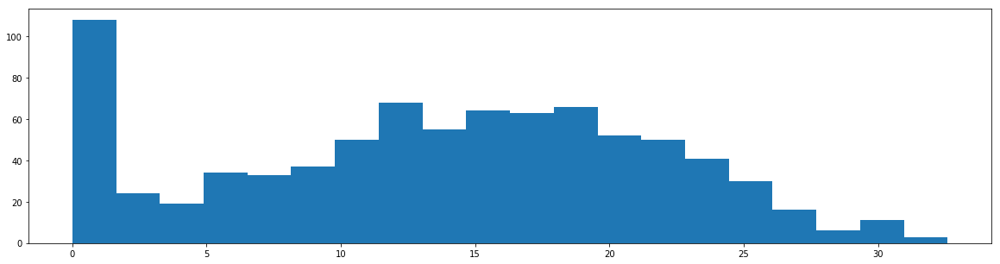

In [31]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.hist(results['prediction'], bins=20)
plt.show()

In [32]:
target_and_predictions = target.join(results)
print(target_and_predictions.shape)
target_and_predictions.head()

(830, 5)


destroyed   latitude  longitude  prediction  \
city  patch_id   date                                                      
daraa 10080-8224 2017-02-07        0.0  32.616861  36.122191    3.097520   
      10208-8288 2017-02-07        0.0  32.616517  36.122878    7.960730   
      10272-4768 2017-02-07        0.0  32.635400  36.123221    7.992837   
      10336-7904 2017-02-07        1.0  32.618577  36.123565    0.000000   
      10400-8160 2017-02-07        0.0  32.617204  36.123908    1.887757   

                             prediction_binary  
city  patch_id   date                           
daraa 10080-8224 2017-02-07                  0  
      10208-8288 2017-02-07                  0  
      10272-4768 2017-02-07                  0  
      10336-7904 2017-02-07                  0  
      10400-8160 2017-02-07                  0

In [33]:
target_and_predictions.to_csv('../figures/target_and_predictions.csv')

### Real data

In [47]:
single_date = date(2017, 2, 7)
target_single_date = target.xs(single_date, level='date')['destroyed']
target_destroyed = target_single_date.loc[target_single_date == 1]
target_non_destroyed = target_single_date.loc[target_single_date == 0]
patches_destroyed = pd.DataFrame([elem[1].split('-') for elem in target_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
patches_non_destroyed = pd.DataFrame([elem[1].split('-') for elem in target_non_destroyed.index.tolist()], columns=['row', 'column']).astype(int)

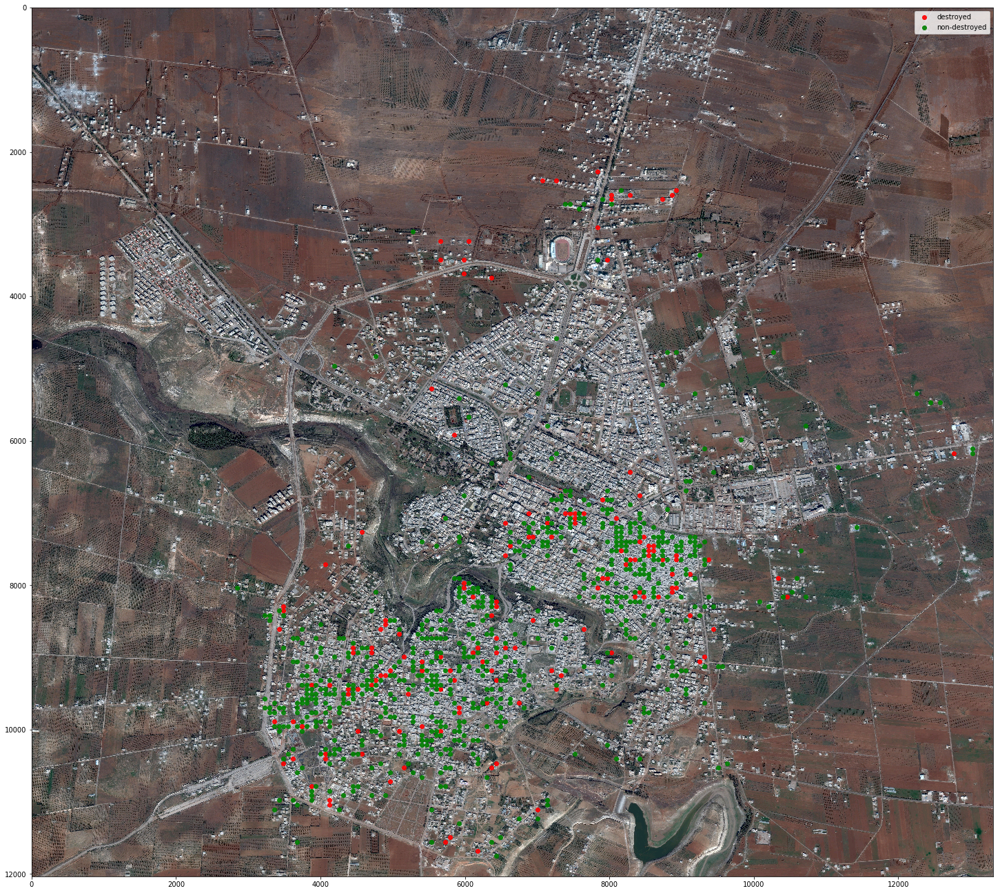

In [48]:
ax = plot_image(raster_array)
ax.scatter(patches_destroyed['row'], patches_destroyed['column'], color='r', label='destroyed', alpha=0.9)
ax.scatter(patches_non_destroyed['row'], patches_non_destroyed['column'], color='g', label='non-destroyed', alpha=0.9)
plt.legend()
plt.savefig(f'../figures/daraa_target_{str(single_date)}.pdf', dpi=500)

### Predicted

In [45]:
results_single_date = results.xs(date(2017, 2, 7), level='date')
prediction_destroyed = results_single_date.loc[results_single_date['prediction_binary'] == 1]
prediction_non_destroyed = results_single_date.loc[results_single_date['prediction_binary'] == 0]
patches_destroyed = pd.DataFrame([elem[1].split('-') for elem in prediction_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
patches_non_destroyed = pd.DataFrame([elem[1].split('-') for elem in prediction_non_destroyed.index.tolist()], columns=['row', 'column']).astype(int)

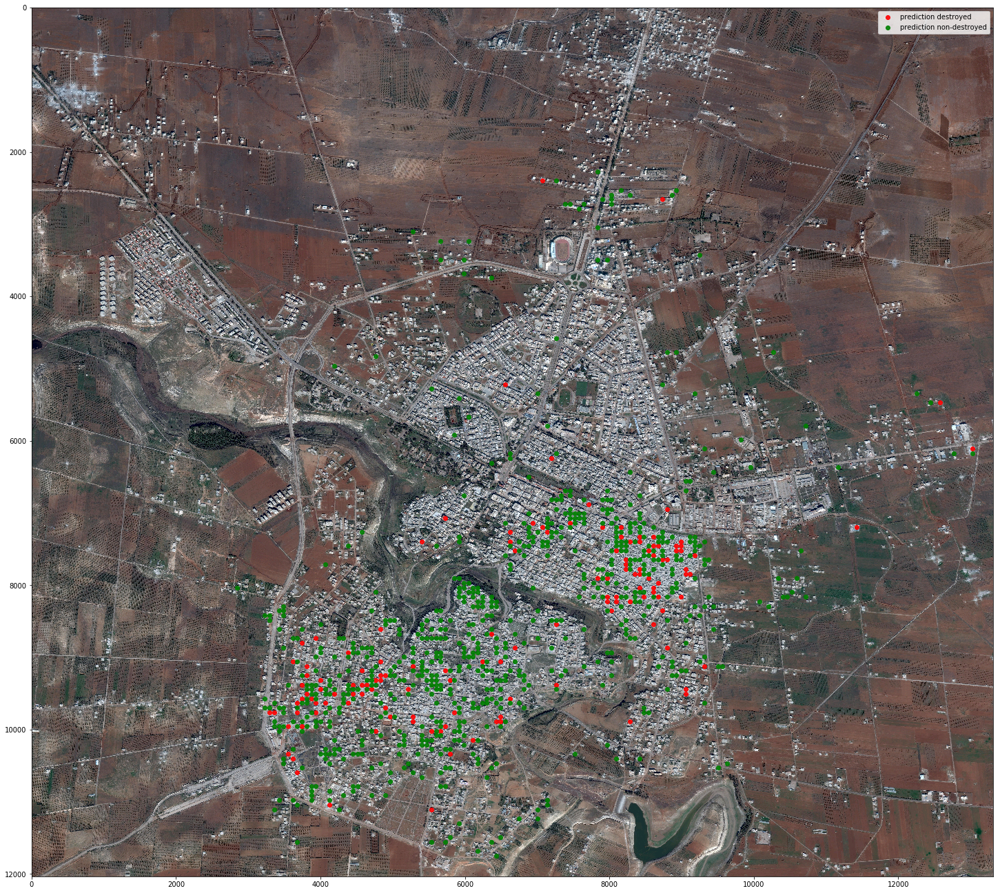

In [46]:
ax = plot_image(raster_array)
ax.scatter(patches_destroyed['row'], patches_destroyed['column'], color='r', label='prediction destroyed', alpha=0.9)
ax.scatter(patches_non_destroyed['row'], patches_non_destroyed['column'], color='g', label='prediction non-destroyed', alpha=0.9)
plt.legend()
#plt.savefig(f'../figures/daraa_predicted_destruction_fitted_{str(single_date)}.pdf', dpi=500)

### Correct predictions

In [38]:
correct_destroyed = target.loc[(target['destroyed'] == 1) & (results['prediction_binary'] == 1)]
correct_non_destroyed = target.loc[(target['destroyed'] == 0) & (results['prediction_binary'] == 0)]
patches_destroyed = pd.DataFrame([elem[1].split('-') for elem in correct_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
patches_non_destroyed = pd.DataFrame([elem[1].split('-') for elem in correct_non_destroyed.index.tolist()], columns=['row', 'column']).astype(int)

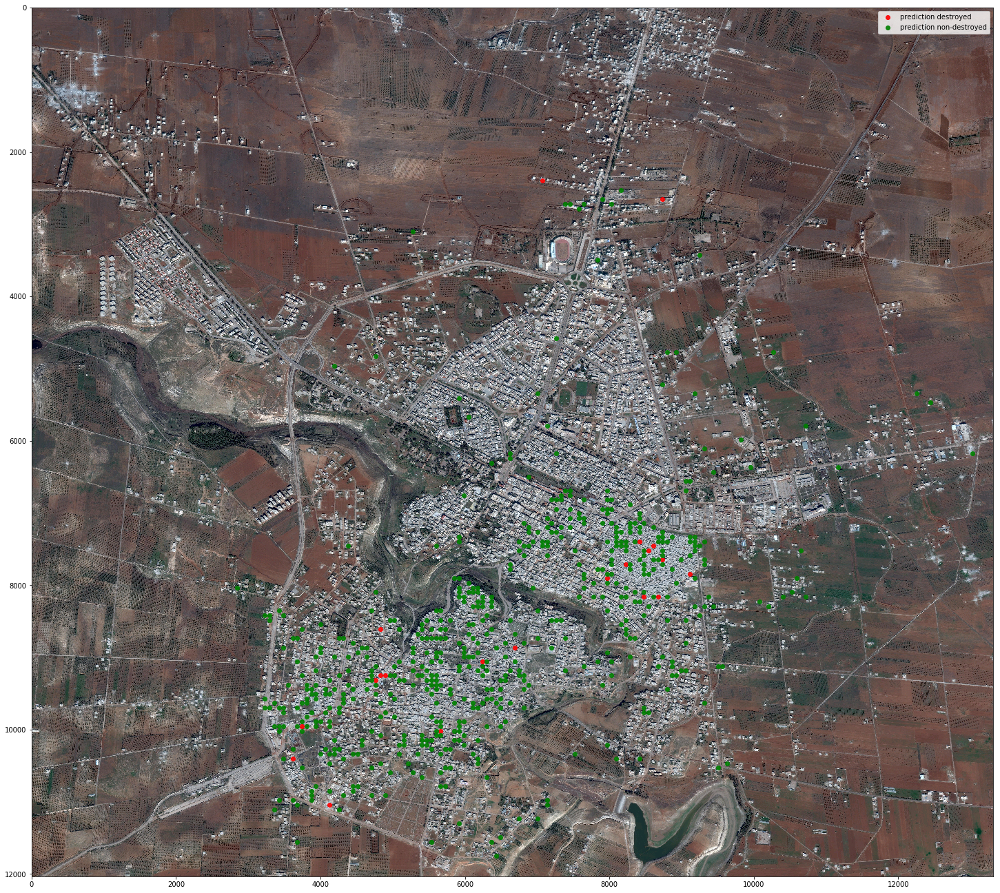

In [39]:
ax = plot_image(raster_array)
ax.scatter(patches_destroyed['row'], patches_destroyed['column'], color='r', label='prediction destroyed', alpha=0.9)
ax.scatter(patches_non_destroyed['row'], patches_non_destroyed['column'], color='g', label='prediction non-destroyed', alpha=0.9)
plt.legend()

### Incorrect predictions

In [49]:
incorrect_destroyed = target.loc[(target['destroyed'] == 1) & (results['prediction_binary'] == 0)]
incorrect_non_destroyed = target.loc[(target['destroyed'] == 0) & (results['prediction_binary'] == 1)]
patches_destroyed = pd.DataFrame([elem[1].split('-') for elem in incorrect_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
patches_non_destroyed = pd.DataFrame([elem[1].split('-') for elem in incorrect_non_destroyed.index.tolist()], columns=['row', 'column']).astype(int)

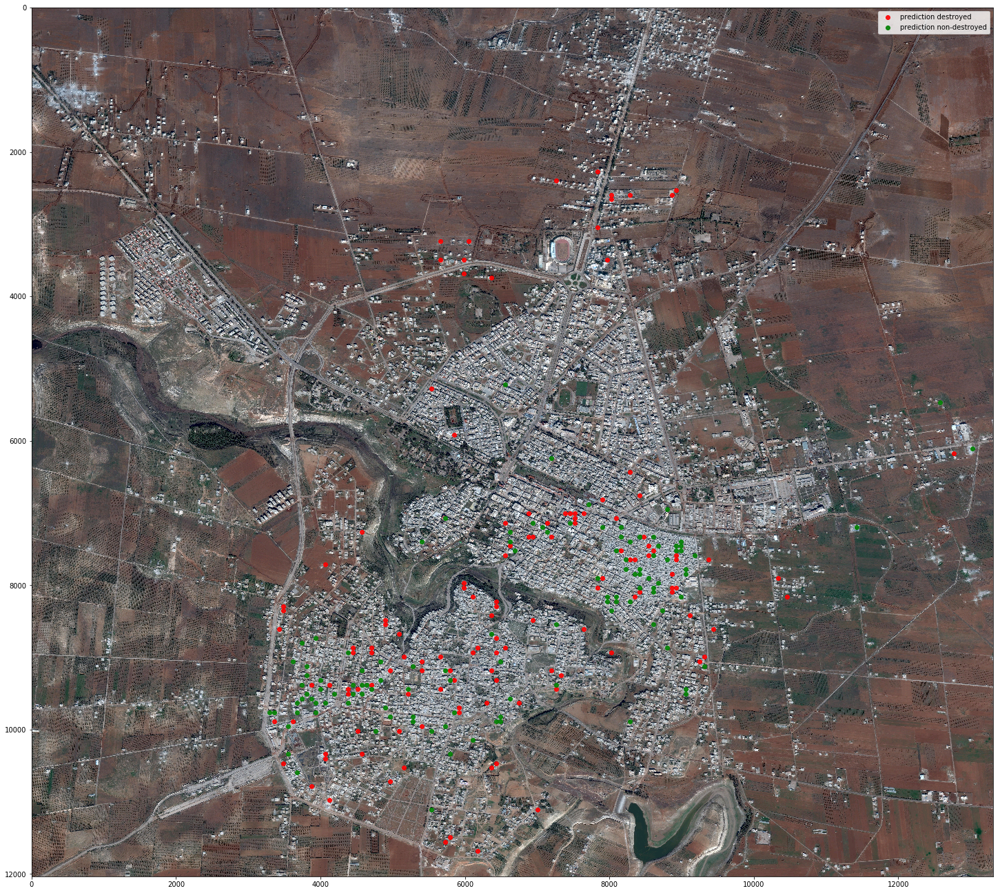

In [50]:
ax = plot_image(raster_array)
ax.scatter(patches_destroyed['row'], patches_destroyed['column'], color='r', label='prediction destroyed', alpha=0.9)
ax.scatter(patches_non_destroyed['row'], patches_non_destroyed['column'], color='g', label='prediction non-destroyed', alpha=0.9)
plt.legend()

## Evolution of destruction over time

In [14]:
# plt.ioff()

# features_path = '../logs/features/target_aleppo.p'
# target = pd.read_pickle(features_path)
# for date in target.index.get_level_values('date').unique():
#     raster_path = f"../data/city_rasters/aleppo_{str(date.date()).replace('-', '_')}_zoom_19.tif"
#     raster = rasterio.open(raster_path)
#     raster_array = RasterSplitter._raster_to_array(raster)
#     _target = target.xs(date, level='date')
#     prediction_destroyed = _target.loc[_target == 1]
#     prediction_non_destroyed = _target.loc[_target == 0]
#     patches_destroyed = pd.DataFrame([elem[1].split('-') for elem in prediction_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
#     patches_non_destroyed = pd.DataFrame([elem[1].split('-') for elem in prediction_non_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
#     ax = plot_image(raster_array)
#     s = 10000/raster_array.shape[0]
#     ax.scatter(patches_destroyed['row'], patches_destroyed['column'], color='r', label='destroyed', alpha=0.8, s=s, marker='s')
#     ax.scatter(patches_non_destroyed['row'], patches_non_destroyed['column'], color='g', label='non-destroyed', alpha=0.8, s=s, marker='s')
#     plt.legend()
#     plt.savefig(f'../figures/target_aleppo_{str(date)}.pdf', dpi=500)

## Evolution of predictions over time

In [13]:
# %%capture # Prevent jupyter from displaying anything
# for date in results.index.get_level_values('date').unique():
#     print(date)
#     _results = results.xs(date, level='date')
#     prediction_destroyed = _results.loc[_results['prediction_binary'] == 1]
#     prediction_non_destroyed = _results.loc[_results['prediction_binary'] == 0]
#     patches_destroyed = pd.DataFrame([elem[1].split('-') for elem in prediction_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
#     patches_non_destroyed = pd.DataFrame([elem[1].split('-') for elem in prediction_non_destroyed.index.tolist()], columns=['row', 'column']).astype(int)
#     ax = plot_image(raster_array)
#     ax.scatter(patches_destroyed['row'], patches_destroyed['column'], color='r', label='prediction destroyed', alpha=0.4, s=1, marker='s')
#     ax.scatter(patches_non_destroyed['row'], patches_non_destroyed['column'], color='g', label='prediction non-destroyed', alpha=0.4, s=1, marker='s')
#     plt.legend()
#     plt.savefig(f'../figures/prediction_{str(date)}.pdf', dpi=200)

## Evolution of performance over time

In [52]:
# from sklearn.metrics import classification_report

# dates = target.index.get_level_values('date').unique()
# prediction_and_target = target.join(results).dropna(subset=['destroyed'])
# for date in dates:
#     print(date)
#     try:
#         _prediction = prediction_and_target.xs(date, level='date')['prediction_binary'].map({1: '1 (destroyed)', 0: '0 (non-destroyed)'})
#         _target = prediction_and_target.xs(date, level='date')['destroyed'].map({1: '1 (destroyed)', 0: '0 (non-destroyed)'})
#     except KeyError:
#         print('no predictions for date', date)
#         continue
        
#     print(classification_report(_target, _prediction))

2013-05-26 00:00:00
no predictions for date 2013-05-26 00:00:00
2013-09-23 00:00:00
                   precision    recall  f1-score   support

0 (non-destroyed)       1.00      1.00      1.00     87349
    1 (destroyed)       0.12      0.03      0.05       103

        micro avg       1.00      1.00      1.00     87452
        macro avg       0.56      0.51      0.52     87452
     weighted avg       1.00      1.00      1.00     87452

2013-10-31 00:00:00
                   precision    recall  f1-score   support

0 (non-destroyed)       1.00      1.00      1.00     87349
    1 (destroyed)       0.11      0.05      0.07       103

        micro avg       1.00      1.00      1.00     87452
        macro avg       0.55      0.52      0.53     87452
     weighted avg       1.00      1.00      1.00     87452

2014-05-23 00:00:00
                   precision    recall  f1-score   support

0 (non-destroyed)       0.99      1.00      0.99     86633
    1 (destroyed)       0.16      0.04     